<a href="https://colab.research.google.com/github/elsioantunes/proc-video/blob/main/testes_opencv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Corners detection  e  Scale-Invariant Feature Transform (SIFT)


## Objetivos:

1. Aplicar uma quantidade de conceitos de processamento de vídeo da disciplina.
 $\color{#DDDD00}{\text{em processo}}$
2.  Estudar detecção de cantos e bordas e os algoritmos de Harris e Shi-Tomasi. $\color{#00DD00}{\text{OK}}$
3.  Estudar e aplicar os mecanismos de SIFT (Scale-Invariant Feature Transform) $\color{#00dd00}{\text{OK}}$



In [202]:
import pandas as pd
import numpy as np
import random as rnd
import cv2 as cv
import seaborn as sns

sns.set_theme()

from base64 import b64encode, b64decode
from google.colab.patches import cv2_imshow
from google.colab.output import eval_js
from IPython.display import HTML, Image, display, Javascript
 
def show(img):
    return cv2_imshow(img)

def show2(img1, img2):
    show(np.hstack([dim3(img1), dim3(img2)]))
 
def putext(img, txt, cor=(255, 255, 255), lin=0):
    cv.putText(img,  str(txt), (7, 26 + lin*25), cv.FONT_HERSHEY_SIMPLEX, 0.7, (32, 32, 32), 2, cv.LINE_AA)
    cv.putText(img,  str(txt), (5, 25 + lin*25), cv.FONT_HERSHEY_SIMPLEX, 0.7, cor, 1, cv.LINE_AA)

def rndColor():
    r = rnd.randrange(50, 240)
    g = rnd.randrange(50, 240)
    b = rnd.randrange(50, 240)
    return (r, g, b)
 
def dim3(img):
    if len(img.shape) == 2:
        img = cv.merge([img, img, img])
    return img.astype('uint8')
 

def image(url='cuboMesa1.jpg', width=400):
    img = cv.imread(url)
    h, w = img.shape[:2]
    height = int(h*width/w)
    img = cv.resize(img, (width, height))
    return img

from ipywidgets import IntProgress

def openVideo(url):
    cap = cv.VideoCapture(url)
    ret, frame = cap.read()
    h, w = frame.shape[:2]
    fps = cap.get(cv.CAP_PROP_FPS)
    fc = cap.get(cv.CAP_PROP_FRAME_COUNT)
    print("frame count:", fc)
    print("width, height, fps:", w, h, fps)
    return fc, w, h, cap

def newVideo(frame, outUrl='video.mp4', codec='VP90'):
    fourcc = cv.VideoWriter_fourcc(*codec)
    h, w = frame.shape[:2]
    return cv.VideoWriter(outUrl, fourcc, 25, (w, h))

def rotate(img, ang):
    h, w = img.shape[:2]
    matrix = cv.getRotationMatrix2D((w/2, h/2), ang, 1)
    return  cv.warpAffine(img, matrix, (w, h))


!curl -o cuboBar.jpg https://elsioantunes.github.io/proc-video/cuboBar.jpg
!curl -o cuboEmbar.jpg https://elsioantunes.github.io/proc-video/cuboEmbar.jpg
!curl -o cores321.png https://elsioantunes.github.io/proc-video/cores321.png
!curl -o a.jpg https://elsioantunes.github.io/proc-video/a.jpg
!curl -o a1.jpg https://elsioantunes.github.io/proc-video/a1.jpg

!curl -o cuboMesa1.jpg https://elsioantunes.github.io/proc-video/cuboMesa1.jpg
!curl -o cuboMesa2a.jpg https://elsioantunes.github.io/proc-video/cuboMesa2a.jpg
!curl -o cuboMesa2b.jpg https://elsioantunes.github.io/proc-video/cuboMesa2b.jpg
!curl -o cuboMesa3a.jpg https://elsioantunes.github.io/proc-video/cuboMesa3a.jpg
!curl -o cuboMesa3b.jpg https://elsioantunes.github.io/proc-video/cuboMesa3b.jpg
!curl -o cuboMesa4.jpg https://elsioantunes.github.io/proc-video/cuboMesa4.jpg


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 85940  100 85940    0     0   240k      0 --:--:-- --:--:-- --:--:--  239k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  107k  100  107k    0     0   389k      0 --:--:-- --:--:-- --:--:--  389k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  457k  100  457k    0     0  1008k      0 --:--:-- --:--:-- --:--:-- 1006k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4500  100  4500    0     0  15463      0 --:--:-- --:--:-- --:--:-- 15463
  % Total    % Received % Xferd  Average Speed   Tim

Vamos utilizar duas imagens de cubos mágicos para testar os códigos de detecção de corners. Particularmente, me interessa definir estas figuras de forma vetorial para capturar suas cores (no futuro). 

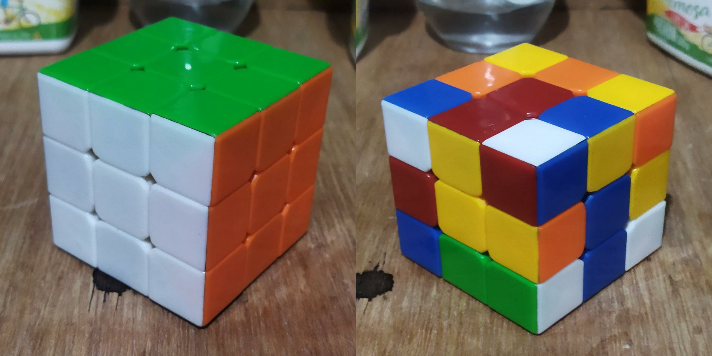

In [ ]:
cubo1 = cv.imread('cuboBar.jpg')
cubo2 = cv.imread('cuboEmbar.jpg')

h, w = cubo1.shape[:2]
cubo1m = cv.resize(cubo1, (w//3, h//3))

h, w = cubo1.shape[:2]
cubo2m = cv.resize(cubo2, (w//3, h//3))

show2(cubo1m, cubo2m)

A visão humana consegue determinar facilmente os cantos e até outras nuances desses objetos. Mas para que um algoritmo possa ver isso é necessário recorrer a teoria sobre como funciona a detecção de cantos, inicialmente estudada por **Chris Harris & Mike Stephens** em 1988. Segundo Harris, os cantos são regiões com irradiações de intensidades diferentes para todas as direções de cada pixel. Esta descrição é relativamente fácil de descrever matemáticamente:<br><br> 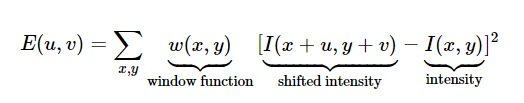

Como se pode ver de forma clara (para matemáticos) esta é uma função que retorna um valor numérico a partir da soma dos quadrados das diferenças de intensidade entre o pixel e sua vizinhança.
* Se este número for baixo significa que o pixel está em uniformidade com seus vizinhos, ou seja, independente da cor deste pixel, seus vizinhos tem cores muito próximas. Então, o que queremos é o contrário disto. 

Maximizar esta função é encontrar os pontos que podemos chamar de críticos. Se são ou não corners é uma questão semântica que teremos que resolver. 

## Adaptive threshold

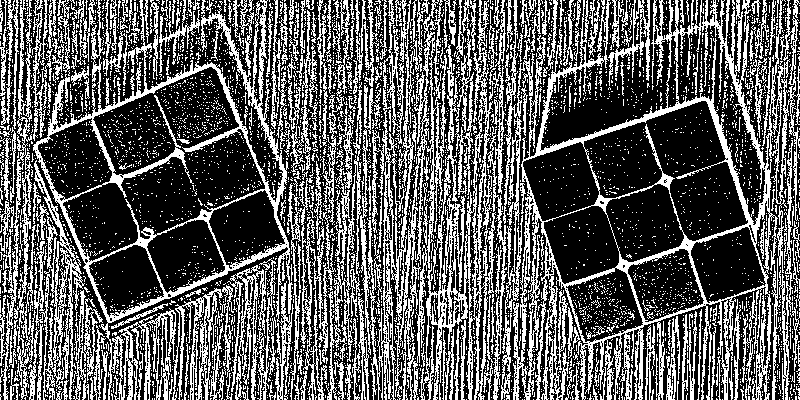

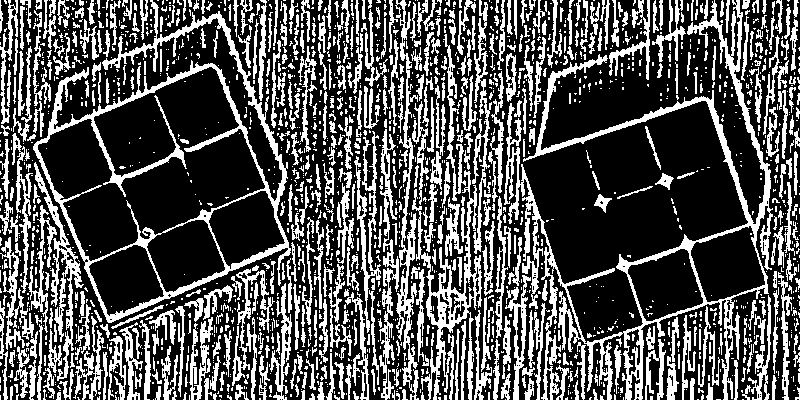

'\ncorn1 = cornersGray(adapt1, img1)\ncorn2 = cornersGray(adapt2, img2)\nshow2(corn1, corn2)\n'

In [ ]:
def cornersGray(img, img1, k=15):
    img2 = dim3(img1/4)
    #img2 = np.zeros_like(img2)
    corners = cv.goodFeaturesToTrack(img, 10000, 0.001, 0, blockSize=k)

    for i in corners:
        x, y = i[0]
        cv.circle(img2, (x, y), 1, (0, 255, 0), 1)
    return img2



img1 = image('cuboMesa3b.jpg')
img2 = image('cuboMesa4.jpg')
#show2(img1, img2)

gray1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
gray2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)
#show2(gray1, gray2)

'''
blur1 = cv.medianBlur(gray1, 5)
blur2 = cv.medianBlur(gray2, 5)
#show2(blur1, blur2)
'''

blur1 = gray1
blur2 = gray2

adaptype = cv.ADAPTIVE_THRESH_GAUSSIAN_C
threshtype = cv.THRESH_BINARY_INV
adapt1 = cv.adaptiveThreshold(blur1, 255, adaptype, threshtype, 11, 2) 
adapt2 = cv.adaptiveThreshold(blur2, 255, adaptype, threshtype, 11, 2) 
show2(adapt1, adapt2)


pipper1 = cv.medianBlur(adapt1, 3)
pipper2 = cv.medianBlur(adapt2, 3)
show2(pipper1, pipper2)




'''
corn1 = cornersGray(adapt1, img1)
corn2 = cornersGray(adapt2, img2)
show2(corn1, corn2)
'''


#https://stackoverflow.com/questions/46565975/find-intersection-point-of-two-lines-drawn-using-houghlines-opencv

## Harris 1

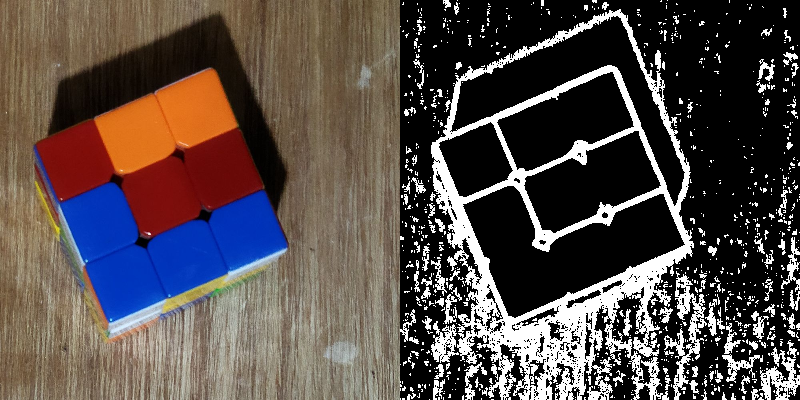

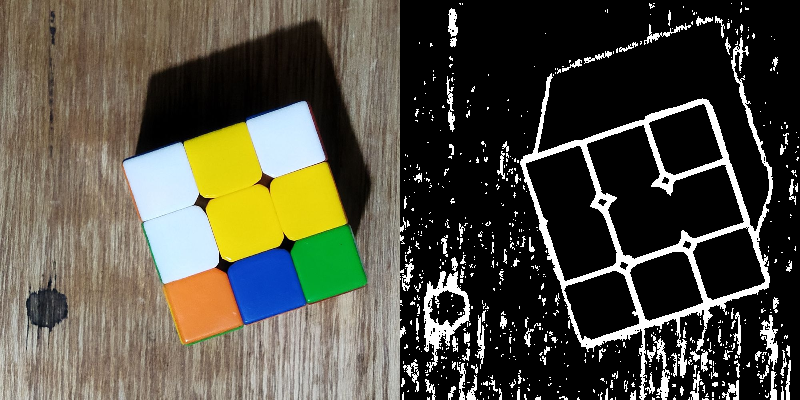

In [ ]:
def Corner2(img):
    r, g, b = cv.split(img)
    r32 = np.float32(r)
    g32 = np.float32(g)
    b32 = np.float32(b)

    dstr = cv.cornerHarris(r32, 3, 5, 0.03)
    dstg = cv.cornerHarris(g32, 3, 5, 0.03)
    dstb = cv.cornerHarris(b32, 3, 5, 0.03)

    ret = np.zeros_like(r) 
    ret[abs(dstb) > dstb.max()/3000] = 255
    ret[abs(dstr) > dstr.max()/3000] = 255
    ret[abs(dstg) > dstg.max()/3000] = 255

    return ret


cubomesa3b = image('cuboMesa3b.jpg')
cubomesa4 = image('cuboMesa4.jpg')

#c1 = Corner2(cubo1m)
#c2 = Corner2(cubo2m)
c3 = Corner2(cubomesa3b)
c4 = Corner2(cubomesa4)

#show2(c1, c2)
show2(cubomesa3b, c3)
show2(cubomesa4, c4)

Parece um resultado melhor que o obtido com o filtro Canny. Foram tentadas várias formas de se obter um esqueleto para representar o cubo no Projeto da disciplina... sem sucesso até agora. A intenção era identificar a posição do cubo e extrair uma versão 3d de onde, possivelmente, seria mais fácil para extrair as cores das posições certas. 

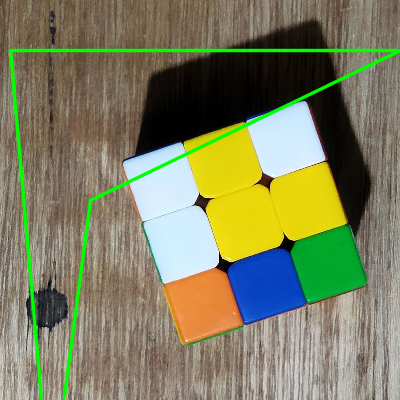

In [ ]:
pts = np.array( [[[10,50], [400,50], [90,200], [50,500]]], np.int32)
img = cubomesa4.copy()
cv.polylines(img, pts, True, (0, 255, 0), 2, cv.LINE_AA)
show(img)

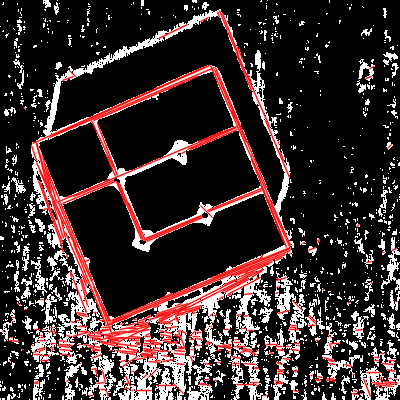

In [ ]:
img = c3.copy()

# cnts, _ = cv.findContours(c4, cv.RETR_LIST, cv.CHAIN_APPROX_NONE)
#for c in cnts:
#    cv.drawContours(img, [c], 0, (0, 255, 0), 1)

#c = max(cnts, key=cv.contourArea)
#c = cv.approxPolyDP(c, 0.005 * cv.arcLength(c, True), True)
# cv.drawContours(img, [c], 0, (0, 255, 0), 1)

if 0:
    lines = cv.HoughLines(img, 1, np.pi/180, 170, 0, 0)
    img = dim3(img) 
    
    if lines is not None:
        for line in lines:
            rho, theta = line[0]
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a*rho
            y0 = b*rho
            x1 = int(x0 - 10*b)
            y1 = int(y0 + 10*a)
            x2 = int(x0 + 10*b)
            y2 = int(y0 - 10*a)
            
            cv.line(img, (x1, y1), (x2, y2), (0, 0, 255), 1, cv.LINE_AA)


if 1:
    lines = cv.HoughLinesP(img, 1, np.pi/180, 170, 1430, 0)
    img = dim3(img) 
    
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv.line(img, (x1, y1), (x2, y2), (0, 0, 255), 1, cv.LINE_AA)



if 0:
    corners = cv.goodFeaturesToTrack(img, 26, 0.1, 2, blockSize=2)
    img = dim3(img)
    for i in corners:
        x, y = i.ravel()
        cv.circle(img, (x, y), 8, (0, 255, 0), 1)

show(img)


## Harris 2

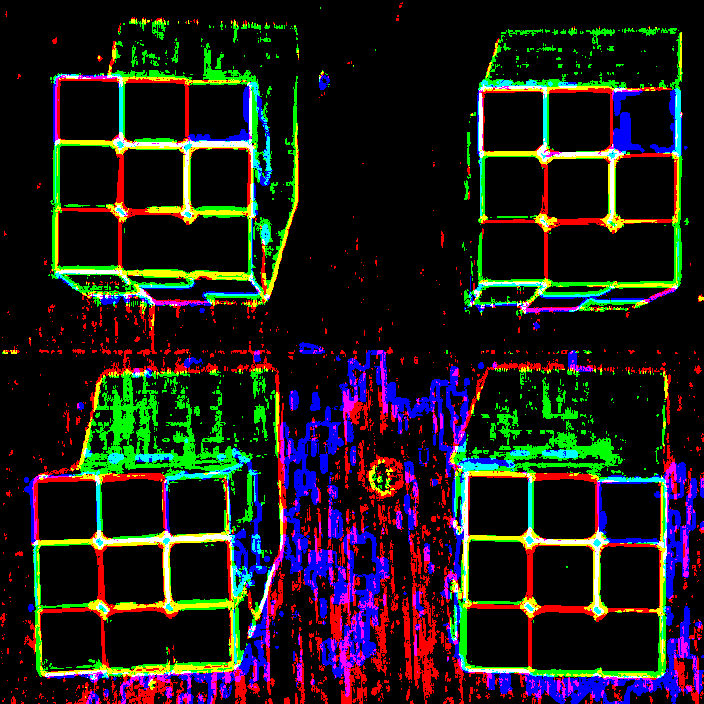

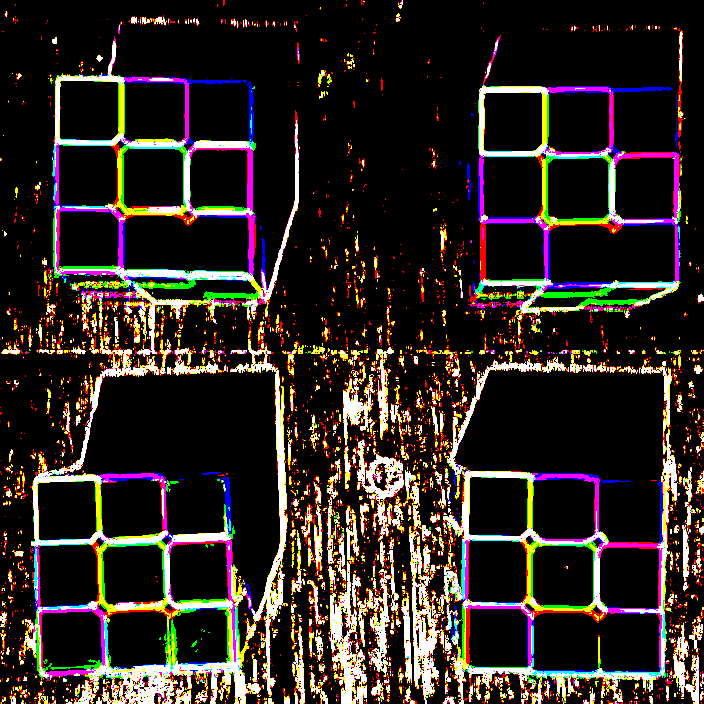

In [ ]:
def Corner2(img, bla=0):
    h, s, v = cv.split(cv.cvtColor(img, cv.COLOR_BGR2HSV))
    r, g, b = cv.split(img)
    h32 = np.float32(h)
    s32 = np.float32(s)
    v32 = np.float32(v)
    r32 = np.float32(r)
    g32 = np.float32(g)
    b32 = np.float32(b)

    dsth = cv.cornerHarris(h32, 3, 5, 0.03)
    dsts = cv.cornerHarris(s32, 3, 5, 0.03)
    dstv = cv.cornerHarris(v32, 3, 5, 0.03)
    dstr = cv.cornerHarris(r32, 3, 5, 0.03)
    dstg = cv.cornerHarris(g32, 3, 5, 0.03)
    dstb = cv.cornerHarris(b32, 3, 5, 0.03)

    ret1 = np.zeros_like(img) 
    ret2 = np.zeros_like(img) 

    ret1[abs(dsth) > dsth.max()/3000, 0] = 255
    ret1[abs(dsts) > dsts.max()/3000, 1] = 255
    ret1[abs(dstv) > dstv.max()/3000, 2] = 255

    ret2[abs(dstb) > dstb.max()/3000, 0] = 255
    ret2[abs(dstr) > dstr.max()/3000, 1] = 255
    ret2[abs(dstg) > dstg.max()/3000, 2] = 255

    '''
    ret[abs(dsth) > dsth.max()/3000] = (255, 255, 0)
    ret[abs(dsts) > dsts.max()/3000] = (0, 255, 255)
    ret[abs(dstv) > dstv.max()/3000] = (255, 0, 255)
    '''

    if bla: return ret1
    return ret2


cubo1m = cv.imread('cores321.png')
show(Corner2(cubo1m, 1))
show(Corner2(cubo1m))

Parece um resultado melhor que o obtido com o filtro Canny. Foram tentadas várias formas de se obter um esqueleto para representar o cubo no Projeto da disciplina... sem sucesso até agora. A intenção era identificar a posição do cubo e extrair uma versão 3d de onde, possivelmente, seria mais fácil para extrair as cores das posições certas. 

## func1

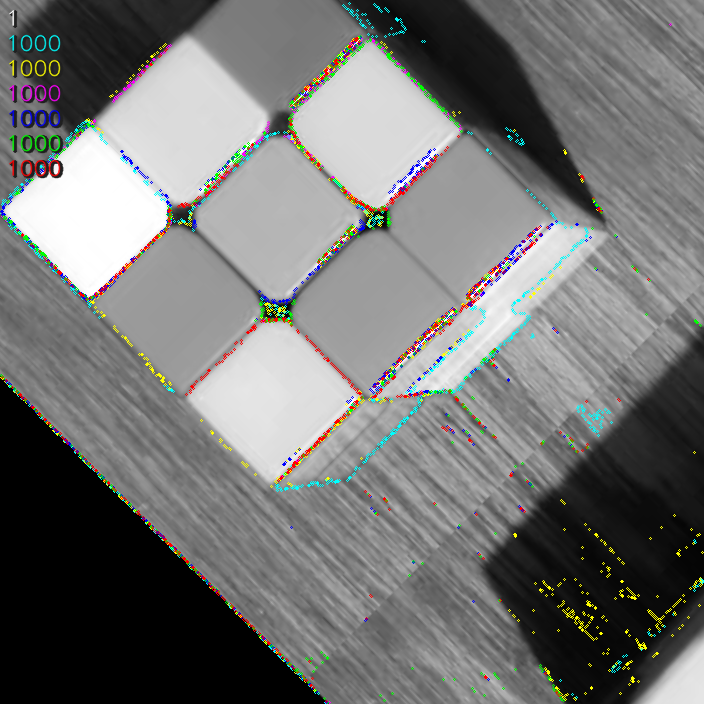

In [ ]:
def rotate(img):
    h, w = img.shape[:2]
    matrix = cv.getRotationMatrix2D((155, 180/2), 45, 2)
    return  cv.warpAffine(img, matrix, (w, h))

def cornersHSVRGB1(img, k = 1, m = 5, video=False):
    if not video:
        img = rotate(img)
    h, w = img.shape[:2]
    
    if video:
        img = cv.medianBlur(img, 2*m+1)

    h, s, v = cv.split(cv.cvtColor(img, cv.COLOR_RGB2HSV))
    r, g, b = cv.split(img)

    img2 = dim3(v)

    tasks = [
        [h, (255, 255, 0)],
        [s, (0, 255, 255)],
        [v, (255, 0, 255)],
        [r, (255, 0, 0)],
        [g, (0, 255, 0)],
        [b, (0, 0, 255)],
    ]
    res = []

    for layer, cor in tasks:
        corners = cv.goodFeaturesToTrack(layer, 1000, 0.001, 0, blockSize=k)
        hlen = corners.shape[0]
        res.append([hlen, cor])
        for i in corners:
            x, y = i.ravel()
            cv.circle(img2, (x, y), 1, cor, 1)

    putext(img2, k)
    for i, (len, cor) in enumerate(res):
        putext(img2, len, cor, i+1)

    return img2

img2 = cornersHSVRGB1(cv.imread('cores321.png'), 1)

show (img2)

## Corners video

Aqui uma série de tentativas de obter significado nos pontos detectados pelos algoritmos de corners. Neste momento, pontos detectados são apenas pontos. Faz-se necessário a interpretação dos mesmos. E isto é feito nas próximas seções quando falaremos de SIFT

In [ ]:
!curl -o v.mp4 https://elsioantunes.github.io/proc-video/cuboPend2.mp4
#!ffmpeg -i v.mp4 -filter_complex "reverse" -y -an video.mp4
!cp v.mp4 /usr/local/share/jupyter/nbextensions/v.mp4

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3337k  100 3337k    0     0  8280k      0 --:--:-- --:--:-- --:--:-- 8280k


trecho para download e visualização do (video a ser processado)

infelizmente não se pode visualizar pelo git. Salve uma cópia deste notebook para ver os resultados

In [ ]:
%%html
<video controls>
    <source src='nbextensions/v.mp4'>
</video>

## Corners video1


In [ ]:
def MaskClose(img, k=10, iterations=1):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel, iterations=iterations)
    return img

def MaskOpen(img, k=10, iterations=1):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_OPEN, kernel, iterations=iterations)
    return img

inUrl = '/usr/local/share/jupyter/nbextensions/v.mp4'
outUrl = '/usr/local/share/jupyter/nbextensions/out.mp4'

out = None
ret = True
totalFrames, w, h, cap = openVideo(inUrl)
totalFrames =  int(totalFrames)

progressBar = IntProgress(min=0, max=totalFrames) 
display(progressBar) 


for i in range(totalFrames):
    data = []
    ret, frame = cap.read()
    if ret:
        gray = cv.cvtColor(frame, cv.COLOR_RGB2GRAY)

        corners = cv.goodFeaturesToTrack(gray, 260, 0.001, 20)
        corners = np.int0(corners)
        for i in corners:
            x, y = i.ravel()
            cv.circle(frame, (x, y), 8, (0, 255, 0), 1)

        corners = cv.goodFeaturesToTrack(gray, 90, 0.1, 20)
        corners = np.int0(corners)
        for i in corners:
            x, y = i.ravel()
            cv.circle(frame, (x, y), 4, (0, 0, 255), -1)

        if out == None: out = newVideo(frame, outUrl)
        
        out.write(frame)
        progressBar.value += 1

cap.release()
out.release()

frame count: 418.0
width, height, fps: 640 352 29.73480537218302


IntProgress(value=0, max=418)

Olha que interessante: os códigos agora vão ter uma progressbar :)

In [ ]:
%%html
<video controls>
    <source src='nbextensions/out.mp4'>
</video>

se precisar baixar este video, prefira a versão em m4v que poderá ser convertido com o ffmpeg abaixo e baixado pela pastinha ao lado

In [ ]:
!ffmpeg -i {outUrl} -y video.m4v

## HoughLines

51 0.46947157


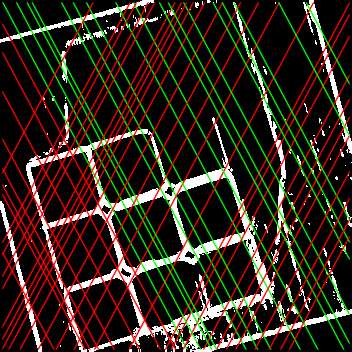

In [ ]:
# https://caphuuquan.blogspot.com/2017/04/building-simple-sudoku-solver-from.html
def Corner2(img, bla=0):
    r, g, b = cv.split(img)
    r32 = np.float32(r)
    g32 = np.float32(g)
    b32 = np.float32(b)
    dstr = cv.cornerHarris(r32, 3, 5, 0.03)
    dstg = cv.cornerHarris(g32, 3, 5, 0.03)
    dstb = cv.cornerHarris(b32, 3, 5, 0.03)
    ret = np.zeros_like(r) 
    ret[abs(dstr) > dstr.max()/300] = 255
    ret[abs(dstg) > dstg.max()/300] = 255
    ret[abs(dstb) > dstb.max()/300] = 255
    lines = cv.HoughLines(ret, 2, np.pi/180, 30, 0, 0)
    ret = dim3(ret) 
    
    if lines is not None:
        posh = 0
        posv = 0

        hist = {}
        for line in lines:
            rho, theta = line[0]
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a*rho
            y0 = b*rho
            x1 = int(x0 - 1000*b)
            y1 = int(y0 + 1000*a)
            x2 = int(x0 + 1000*b)
            y2 = int(y0 - 1000*a)
            
            key = str(b)
            if b == 0: continue
            if key == "0.70710677": continue
            if key == "0.8746197": continue 
            if key == "0.9848077": continue 
            hist[key] = hist.get(key, 0) + 1
            
            if key == "0.46947157":
                
                if rho > 0:
                    cv.line(ret, (x1, y1), (x2, y2), (0, 0, 255), 1, cv.LINE_AA)
                else:
                    cv.line(ret, (x1, y1), (x2, y2), (0, 255, 0), 1, cv.LINE_AA)
        
        histm = 0
        for i in hist:
            if hist[i] > histm:
                histm = hist[i]
                key = i
        print (hist[key], key)
            

    return ret

img = cv.imread('cores321.png')
h, w = img.shape[:2]
img = img[h//2:h, :w//2, ]
img = rotate(img, 15)

show(Corner2(img))


## Stripes!

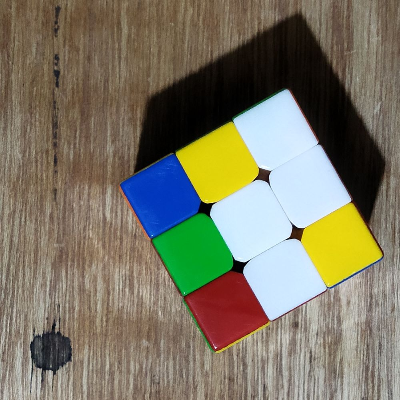

In [ ]:
show(image())

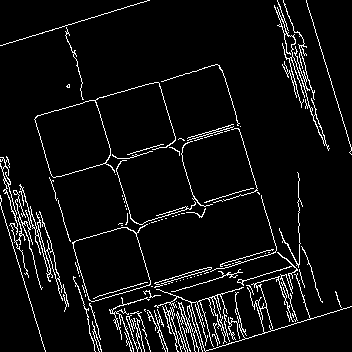

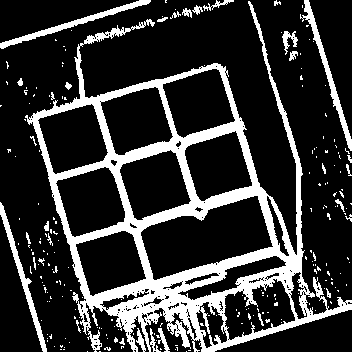

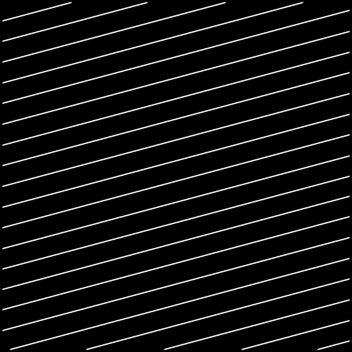

4138 15


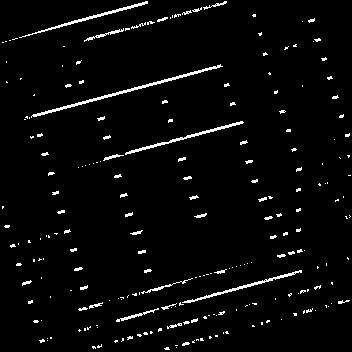

In [ ]:
def stripes(img, theta):
    if len(img.shape) != 2:
        img, _, _ = cv.split(img)
    mask = np.zeros_like(img)
    for rho in range(0, 500, 20):
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a*rho
        y0 = b*rho
        x1 = int(x0 - 1000*b)
        y1 = int(y0 + 1000*a)
        x2 = int(x0 + 1000*b)
        y2 = int(y0 - 1000*a)
        cv.line(mask, (x1, y1), (x2, y2), (255, 255, 255), 1, cv.LINE_AA)
    return mask    

def Harris(img):
    r, g, b = cv.split(img)
    r32 = np.float32(r)
    g32 = np.float32(g)
    b32 = np.float32(b)
    dstr = cv.cornerHarris(r32, 3, 5, 0.03)
    dstg = cv.cornerHarris(g32, 3, 5, 0.03)
    dstb = cv.cornerHarris(b32, 3, 5, 0.03)
    ret = np.zeros_like(r) 
    ret[abs(dstr) > dstr.max()/3000] = 255
    ret[abs(dstg) > dstg.max()/3000] = 255
    ret[abs(dstb) > dstb.max()/3000] = 255
    return ret


img = cv.imread('cores321.png')
h, w = img.shape[:2]
#img = img[h//2:h, :w//2, ]
img = img[:h//2, :w//2]
img = rotate(img, 17)

canny = cv.Canny(img, 0, 255)
show(canny)

harris = Harris(img)
show(harris)

if 0:
    for i in range(0, 91, 1):
        test1 = stripes(harris, np.pi/2 - i*np.pi/(2*90))
        test1 = cv.bitwise_and(harris, harris, mask=test1)
        print (cv.countNonZero(test1), i)

else:
    i = 15
    test1 = stripes(harris, np.pi/2 - i*np.pi/(2*90))
    show(test1)
    test1 = cv.bitwise_and(harris, harris, mask=test1)

    print (cv.countNonZero(test1), i)
    show(test1)

## Stripes!!

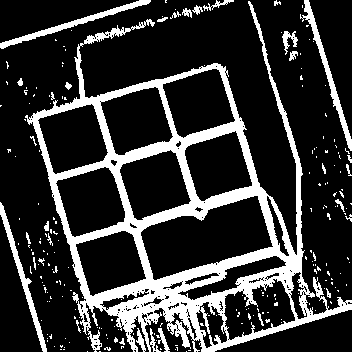

2529 0
2347 1
2485 2
2501 3
2161 4
1509 5
1829 6
2395 7
2721 8
2517 9
2693 10
2677 11
2219 12
1749 13
1347 14
1701 15
2203 16
2817 17
2509 18
3165 19
3943 20
3981 21
3695 22
3217 23
2613 24
2007 25
1735 26
1889 27
2145 28
3281 29
3507 30
3299 31
3547 32
3649 33
3841 34
3485 35
3333 36
3539 37
3363 38
3299 39
3533 40
3383 41
3225 42
3015 43
3047 44
2381 45
2751 46
2513 47
2171 48
1859 49
1525 50
1281 51
2737 52
2843 53
2821 54
3115 55
3511 56
3095 57
2987 58
2817 59
2843 60
2615 61
2405 62
2259 63
2343 64
2181 65
1795 66
1689 67
2817 68
3217 69
3009 70
2457 71
2235 72
2363 73
2509 74
2405 75
2407 76
2481 77
2471 78
2315 79
2611 80
2887 81
2487 82
2441 83
2601 84
2981 85
2759 86
2529 87
2899 88
2983 89
1977 90


In [ ]:
def stripes(img, theta):
    if len(img.shape) != 2:
        img, _, _ = cv.split(img)
    mask = np.zeros_like(img)
    for rho in range(0, 500, 20):
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a*rho
        y0 = b*rho
        x1 = int(x0 - 1000*b)
        y1 = int(y0 + 1000*a)
        x2 = int(x0 + 1000*b)
        y2 = int(y0 - 1000*a)
        cv.line(mask, (x1, y1), (x2, y2), (255, 255, 255), 8, cv.LINE_8)
    return mask    

def Harris(img):
    r, g, b = cv.split(img)
    r32 = np.float32(r)
    g32 = np.float32(g)
    b32 = np.float32(b)
    dstr = cv.cornerHarris(r32, 3, 5, 0.03)
    dstg = cv.cornerHarris(g32, 3, 5, 0.03)
    dstb = cv.cornerHarris(b32, 3, 5, 0.03)
    ret = np.zeros_like(r) 
    ret[abs(dstr) > dstr.max()/3000] = 255
    ret[abs(dstg) > dstg.max()/3000] = 255
    ret[abs(dstb) > dstb.max()/3000] = 255
    return ret


img = cv.imread('cores321.png')
h, w = img.shape[:2]
#img = img[h//2:h, :w//2, ]
img = img[:h//2, :w//2]
img = rotate(img, 17)

harris = Harris(img)
show(harris)

if 1:
    for i in range(0, 91, 1):
        strip = stripes(harris, (90 - i)*np.pi/(2*90))
        test1 = cv.bitwise_and(harris, harris, mask=strip)
        test2 = cv.bitwise_and(harris, harris, mask=255-strip)
        calc = abs(cv.countNonZero(test2) - cv.countNonZero(test1))
        print (calc, i)

else:
    i = 17
    strip = stripes(harris, (90 - i)*np.pi/(2*90))
    show(strip)
    show(255-strip)
    test1 = cv.bitwise_and(harris, harris, mask=strip)
    test2 = cv.bitwise_and(harris, harris, mask=255-strip)
    print (cv.countNonZero(test1), i)
    show(test1)
    show(test2)
    

## Sift
 

In [ ]:
!pip install opencv-python==3.4.2.16 opencv-contrib-python==3.4.2.16

ERROR: Could not find a version that satisfies the requirement opencv-python==3.4.2.16 (from versions: 3.4.2.17, 3.4.3.18, 3.4.4.19, 3.4.5.20, 3.4.6.27, 3.4.7.28, 3.4.8.29, 3.4.9.31, 3.4.9.33, 3.4.10.35, 3.4.10.37, 3.4.11.39, 3.4.11.41, 3.4.11.43, 3.4.11.45, 3.4.13.47, 3.4.14.51, 3.4.14.53, 3.4.15.55, 4.0.0.21, 4.0.1.23, 4.0.1.24, 4.1.0.25, 4.1.1.26, 4.1.2.30, 4.2.0.32, 4.2.0.34, 4.3.0.36, 4.3.0.38, 4.4.0.40, 4.4.0.42, 4.4.0.44, 4.4.0.46, 4.5.1.48, 4.5.2.52, 4.5.2.54, 4.5.3.56)
ERROR: No matching distribution found for opencv-python==3.4.2.16


In [ ]:
img = cv.imread('cores321.png', cv.IMREAD_GRAYSCALE)
h, w = img.shape[:2]

img1 = img[:h//2, :w//2]
img2 = img[h//2:h, :w//2]

sift = cv.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

bf = cv.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

# cv.drawMatchesKnn expects list of lists as matches.
img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

show (img3)

A tentativa de executar o código original do SIFT falhou e não encontrei nenhum jeito fácil de instalar para rodar a função. Disseram que tem um problema de patente que faz com que nem todas as versões do openCV possam utilizá-lo. Comecei então a procurar uma forma de implementar o código por fora do openCV

## Corners3b video

In [ ]:
inUrl = '/usr/local/share/jupyter/nbextensions/v.mp4'
outUrl = '/usr/local/share/jupyter/nbextensions/out.mp4'

out = None
ret = True
totalFrames, w, h, cap = openVideo(inUrl)
totalFrames = 150 #int(totalFrames)

progressBar = IntProgress(min=0, max=totalFrames*10) 
display(progressBar) 

ret, frame = cap.read()
out = newVideo(frame, outUrl)

for j in [1, 2, 10]:
    _, w, h, cap = openVideo(inUrl)
    for i in range(totalFrames):
        data = []
        ret, frame = cap.read()
        if ret:
            frame2 = cornersHSVRGB1(frame, j, video=True)
            out.write(frame2)
            
            progressBar.value += 1
    cap.release()

out.release()

frame count: 418.0
width, height, fps: 640 352 29.73480537218302


IntProgress(value=0, max=1500)

frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame count: 418.0
width, height, fps: 640 352 29.73480537218302


In [ ]:
%%html
<video controls>
    <source src='nbextensions/out.mp4'>
</video>

In [ ]:
!ffmpeg -i {outUrl} -y video.m4v

## Scale-Invariante Feature Transform

É fácil perceber que os corners que encontramos com `cv.cornerHarris()` e Shi-Tomasi Corner Detector `cv.goodFeaturesToTrack()` são invariantes com relação a rotação pois se baseiam numa minimização de uma equação que analisa uma janela com raio de k vizinhos. No entanto, um corner pode deixar de ser um corner dependendo da escala em que se analisa. 

A seguinte aplicação tem como objetivo o reconhecimento de formas (shapes) em diferentes escalas e transformações afins na imagem, de podo que seja possível reconhecer um caractere ou uma figura geométrica mesmo deformada, rotacionada ou invertida.

* Trata-se de uma comparação de dois conjuntos de pontos (de que se forma o shape) a partir de um algoritmo linear que minimiza uma matriz de distâncias.

* A invariância de escala e rotação se dá a partir da construção de um descritor que guarda nas propriedades dos pontos uma forma de identificação, baseada em coordenadas polares e um histograma, que conta quantos vizinhos existem em uma determinada direção. 

* Uma vez que cada vertice sabe o seu papel dentro de um shape (a posicção que ele ocupa em relação aos demais) fica mais fácil comparar dois conjuntos de pontos em busca de similaridade, não só espacial mas também estrutural


In [ ]:
!curl -o a.jpg https://elsioantunes.github.io/proc-video/a.jpg
!curl -o a1.jpg https://elsioantunes.github.io/proc-video/a1.jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4500  100  4500    0     0  40178      0 --:--:-- --:--:-- --:--:-- 40178
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  7580  100  7580    0     0  57862      0 --:--:-- --:--:-- --:--:-- 57862


In [ ]:
'''
    Shape Context descriptor and fast characters recognition

    código obtido em: 
    https://medium.com/machine-learning-world/shape-context-descriptor-and-fast-characters-recognition-c031eac726f9

'''

from scipy.spatial.distance import cdist, cosine
from scipy.optimize import linear_sum_assignment

class ShapeContext(object):

    def __init__(self, nbins_r=5, nbins_theta=12, r_inner=0.1250, r_outer=2.0):
        # number of radius zones
        self.nbins_r = nbins_r
        
        # number of angles zones
        self.nbins_theta = nbins_theta
        
        # maximum and minimum radius
        self.r_inner = r_inner
        self.r_outer = r_outer

    def _hungarian(self, matrix):
        """
            Here we are solving task of getting similar points from two paths
            based on their cost matrixes. 

            This algorithm has dificulty O(n^3)

            return total modification cost, indexes of matched points
        """
        rows, cols = linear_sum_assignment(matrix)
        indexes = zip(rows, cols)
        total = matrix[rows, cols].sum()
        return total, indexes

    def _cost(self, hi, hj):
        cost = 0
        for k in range(self.nbins_theta * self.nbins_r):
            if (hi[k] + hj[k]):
                cost += ((hi[k] - hj[k])**2) / (hi[k] + hj[k])
        return cost * 0.5

    def cost_by_paper(self, P, Q):
        p, _ = P.shape
        C = np.zeros((p, p))
        for i in range(p):
            for j in range(p):
                C[i, j] = self._cost(Q[j] / p, P[i] / p)
        return C

    def diff(self, P, Q):
        C = self.cost_by_paper(P, Q)
        result = self._hungarian(C)
        return result
        
    def compute(self, points):
        t_points = len(points)

        # getting euclidian distance
        r_array = cdist(points, points)

        # getting two points with maximum distance to norm angle by them
        # this is needed for rotation invariant feature
        am = r_array.argmax()
        max_points = [am / t_points, am % t_points]

        # normalizing
        r_array_n = r_array / r_array.mean()

        # create log space
        r_bin_edges = np.logspace(np.log10(self.r_inner), np.log10(self.r_outer), self.nbins_r)
        r_array_q = np.zeros((t_points, t_points), dtype=int)

        # summing occurences in different log space intervals
        # logspace = [0.1250, 0.2500, 0.5000, 1.0000, 2.0000]
        # 0    1.3 -> 1 0 -> 2 0 -> 3 0 -> 4 0 -> 5 1
        # 0.43  0     0 1    0 2    1 3    2 4    3 5
        for m in range(self.nbins_r):
            r_array_q += (r_array_n < r_bin_edges[m])

        fz = r_array_q > 0

        # getting angles in radians
        theta_array = cdist(points, points, lambda u, v: np.arctan2((v[1] - u[1]), (v[0] - u[0])))
        norm_angle = theta_array[int(max_points[0]), int(max_points[1])]
        
        # making angles matrix rotation invariant
        theta_array = (theta_array - norm_angle * (np.ones((t_points, t_points)) - np.identity(t_points)))

        # removing all very small values because of float operation
        theta_array[np.abs(theta_array) < 1e-7] = 0

        # 2Pi shifted because we need angels in [0,2Pi]
        theta_array_2 = theta_array + 2 * np.pi * (theta_array < 0)
        # Simple Quantization
        theta_array_q = (1 + np.floor(theta_array_2 / (2 * np.pi / self.nbins_theta))).astype(int)

        # building point descriptor based on angle and distance
        nbins = self.nbins_theta * self.nbins_r
        descriptor = np.zeros((t_points, nbins))

        for i in range(t_points):
            sn = np.zeros((self.nbins_r, self.nbins_theta))
            for j in range(t_points):
                if (fz[i, j]):
                    sn[r_array_q[i, j] - 1, theta_array_q[i, j] - 1] += 1
            descriptor[i] = sn.reshape(nbins)

        return descriptor


A partir do momento em que temos uma forma de mapear a posição de cada ponto em relação aos outros pontos, ou seja, temos um descritor para a figura, fica mais fácil comparar e assim utilizar em uma série de aplicações práticas como por ex deteção e reconhecimento de objetos em imagens.

In [ ]:
def getPoints(image, simpleto=100, threshold=50, radius=2):
        """
            That is not very good algorithm of choosing path points, but it will work for our case.
            Idea of it is just to create grid and choose points that on this grid.
        """
        if len(image.shape) > 2:
            image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
        dst = cv.Canny(image, threshold, threshold * 3, 3)
        py, px = np.gradient(image)
        # px, py gradients maps shape can be smaller then input image shape
        points = [index for index, val in np.ndenumerate(dst)
                  if val == 255 and index[0] < py.shape[0] and index[1] < py.shape[1]]
        h, w = image.shape
        _radius = radius
        while len(points) > simpleto:
            newpoints = points
            xr = range(0, w, _radius)
            yr = range(0, h, _radius)
            for p in points:
                if p[0] not in yr and p[1] not in xr:
                    newpoints.remove(p)
                    if len(points) <= simpleto:
                        T = np.zeros((simpleto, 1))
                        for i, (y, x) in enumerate(points):
                            radians = np.arctan2(py[y, x], px[y, x])
                            T[i] = radians + 2 * np.pi * (radians < 0)
                        return points
            _radius += 1

        return points 

img = cv.imread('a.jpg')
a = getPoints(img)
a

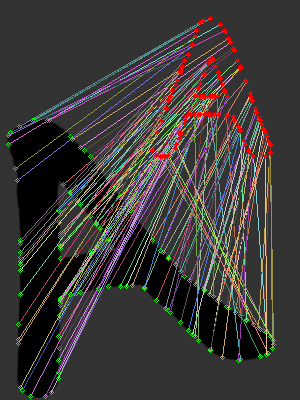

Standard diff: 29.467917473448423


In [ ]:
def getPoints1(img, npoints=100):
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    dst = cv.Canny(img, 50, 150)
    points = cv.findNonZero(dst)
    points = points[:, 0, :]
    idxs = np.random.choice(len(points), npoints)
    return points[idxs]


def plot(img, img2, n=5):
    sc = ShapeContext()

    npoints = 130

    # tentando encontrar o conjunto de ligações com menor distancia
    points1 = getPoints(img, npoints)
    points2 = getPoints(img2, npoints)

    P = sc.compute(points1)
    Q = sc.compute(points2)
    standard_cost, indexes = sc.diff(P, Q)

   
    # plotando e riscando a imagem
    img2 = dim3(img2) / 5
    for y, x in points2:
        cv.circle(img2, (x, y), 2, (0, 255, 0))
    for p, q in indexes:
        y1, x1 = points1[p]
        y2, x2 = points2[q]
        cv.line(img2, (x1, y1), (x2, y2), rndColor(), 1)
    for y, x in points1:
        cv.circle(img2, (x, y), 2, (0, 0, 255), -1)

    show(img2)

    print ("Standard diff:", standard_cost)

img = cv.imread('a.jpg')
img2 = cv.imread('a1.jpg')

plot(img, img2)

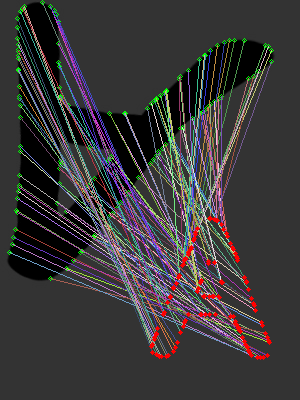

Standard diff: 33.95152144666285


In [ ]:
img = cv.imread('a.jpg')
img2 = cv.imread('a1.jpg')

h, w = img.shape[:2]
img = np.vstack([img[h//2:h, :], img[:h//2, :]])
img2 = img2[::-1]

plot(img, img2, 20)

## shape matching


* Elaborar um discriminador para o shape
* Montar, para cada ponto, um histograma baseado nos pontos vizinhos usando coordenadas polares
* separar em setores circulares de raios em escala logaritmica 
* comparar os discriminadores pela proximidade usando qui quadrado https://pt.wikipedia.org/wiki/Qui-quadrado
* resolver problema  de alocação/atribuição (linear sum assignment)
https://pt.coredump.biz/questions/51409756/minimum-summation-of-difference-of-terms-in-two-lists#51412656




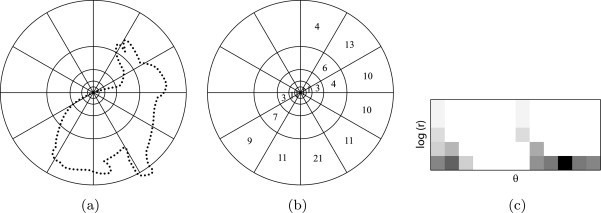

# REFERÊNCIAS



* Shape Context descriptor and fast characters recognition <br> 
https://medium.com/machine-learning-world/shape-context-descriptor-and-fast-characters-recognition-c031eac726f9 


* Documentação OpenCV <br> 
https://docs.opencv.org/4.5.3/db/d27/tutorial_py_table_of_contents_feature2d.html <br> 
https://docs.opencv.org/4.5.3/df/d54/tutorial_py_features_meaning.html<br>
https://docs.opencv.org/4.5.3/dc/d0d/tutorial_py_features_harris.html<br>
https://docs.opencv.org/4.5.3/d4/d8c/tutorial_py_shi_tomasi.html<br>
https://docs.opencv.org/4.5.3/da/df5/tutorial_py_sift_intro.html<br>


* Classificadores treinados para captura de objetos <br> 
https://github.com/opencv/opencv/tree/master/data

* Tutorial Cascade Classifier OpenCV <br> 
https://docs.opencv.org/4.5.3/db/d28/tutorial_cascade_classifier.html

* Object Detection using Haar feature-based cascade classifiers <br> 
<a href='https://colab.research.google.com/github/computationalcore/introduction-to-opencv/blob/master/notebooks/4-Cascade_classification.ipynb#scrollTo=T2JCR1Z47g9L'>https://colab.research.google.com/github/computationalcore/</a>

* Motion Detection OpenCV Python <br> 
https://divyanshushekhar.com/motion-detection-opencv/

* Motion Analysis <br> 
https://docs.opencv.org/4.5.2/de/de1/group__video__motion.html




* Hesse normal form
 <br> https://en.wikipedia.org/wiki/Hesse_normal_form
 


## igualar cores

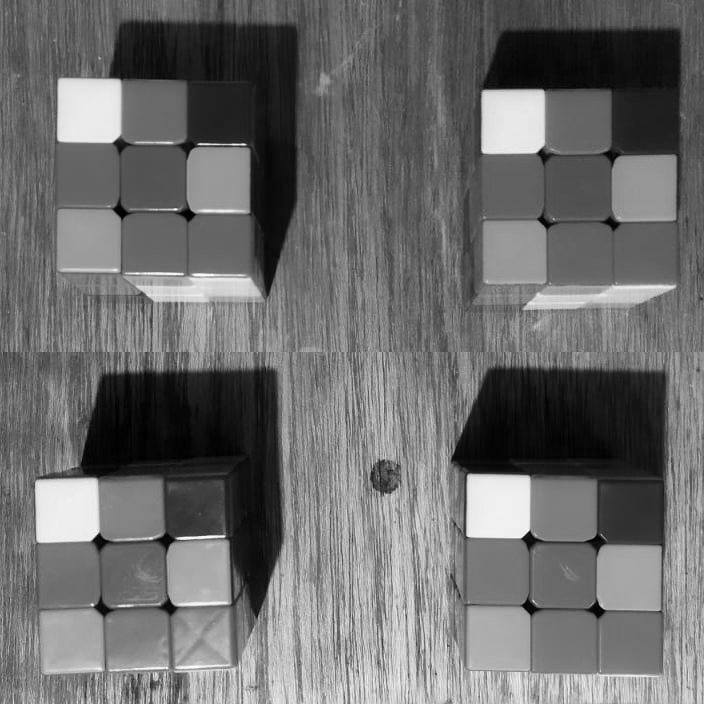

In [ ]:
img = cv.imread('cores321.png')
def Gray(cor):
    #return cor.dot([.3, .59, .11])
    dx = .02
    return cor.dot([.3-dx/2, .59-dx/2, .11+dx])
    
h, w = img.shape[:2]        

test = img.copy()
for y in range(h):
    for x in range(w):
        c = Gray(img[y][x])
        test[y][x] = (c, c, c)
show(test)

## Pesquisa de cores

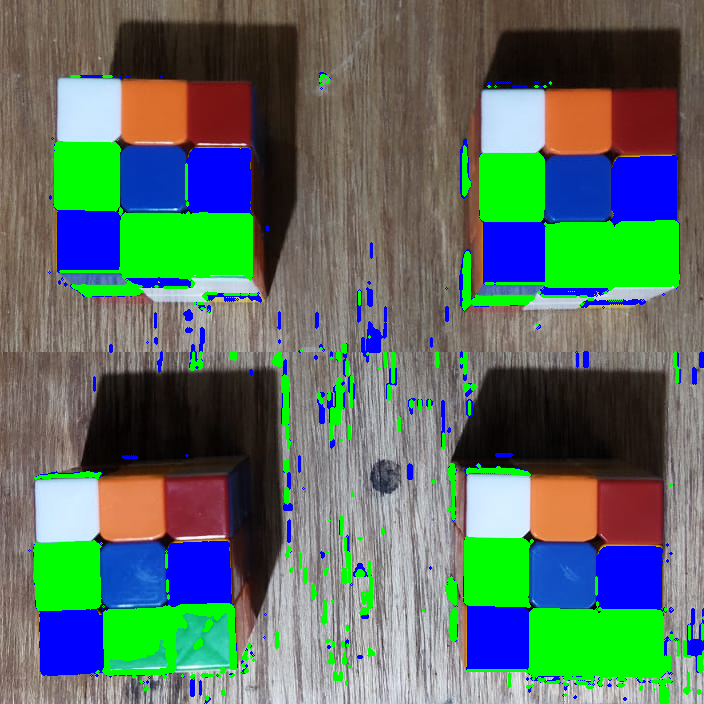

In [ ]:
cores321 = cv.imread('cores321.png')
h, w = cores321.shape[:2]

img = cores321.copy()
'''
for y in range(h):
    for x in range(w):
        img[y, x] = 255 - cores321[y, x]
'''
imgHSV = cv.cvtColor(img, cv.COLOR_BGR2HSV)
hue = imgHSV[...,0]
(rows1, cols1) = np.where(np.logical_and(hue >= 26, hue <= 35))
(rows2, cols2) = np.where(np.logical_and(hue >= 36, hue <= 77))

for r, c in zip(rows1, cols1):
    cv.circle(img, (c, r), 1, (255, 0, 0))

for r, c in zip(rows2, cols2):
    cv.circle(img, (c, r), 1, (0, 255, 0))

show (img)


## scipy cdist


In [ ]:
from scipy.spatial.distance import pdist
X = np.array([[0,0],[0,3],[4,3],[0,6]])
print(pdist(X))

[3. 5. 6. 4. 3. 5.]


## stripes 'renda'

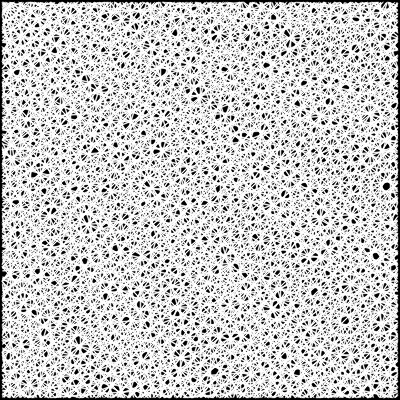

In [200]:
def stripes(src, theta=np.pi/4, side=400, step=10):
    diag = int(side * np.sqrt(2))     

    a = np.cos(theta)
    b = np.sin(theta)
    for rho in range(0, diag, step):
        x0 = a*rho
        y0 = b*rho
        x1 = int(x0 - diag*b) 
        y1 = int(y0 + diag*a) 
        x2 = int(x0 + diag*b) 
        y2 = int(y0 - diag*a) 
        cv.line(src, (x1, y1), (x2, y2), (255, 255, 255), 1, cv.LINE_AA)
    return src

side = 400
src = np.zeros((side, side, 3), np.uint8)

img = stripes(src)
nstr = 21
for i in range(nstr):
    img = stripes(img, 2*np.pi*i/nstr)

show(img)

## Hough Circles

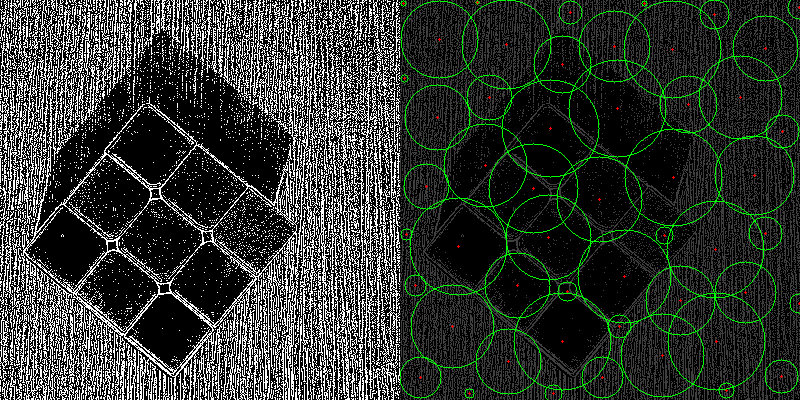

In [280]:
img = image('cuboMesa2a.jpg')
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
#gray = cv.medianBlur(gray, 3)

adaptype = cv.ADAPTIVE_THRESH_GAUSSIAN_C
threshtype = cv.THRESH_BINARY_INV
adapt = cv.adaptiveThreshold(gray, 255, adaptype, threshtype, 3, 2) 

circles = cv.HoughCircles(adapt, cv.HOUGH_GRADIENT, 1, 50, param1=200, param2=3, minRadius=2, maxRadius=50)

gray = dim3(adapt/4)

if circles is not None:
    for x, y, r in circles[0]:
        cv.circle(gray, (x, y), r, (0, 255, 0), 1)
        cv.circle(gray, (x, y), 1, (0, 0, 255), -1)

show2(adapt, gray)

## Hough 

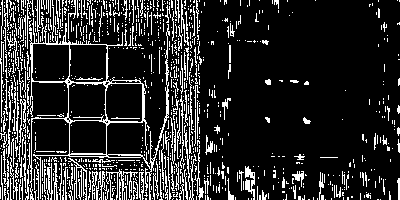

'\ncircles = cv.HoughCircles(adapt, cv.HOUGH_GRADIENT, 1, 50, param1=200, param2=3, minRadius=2, maxRadius=50)\ngray = dim3(adapt/4)\nif circles is not None:\n    for x, y, r in circles[0]:\n        cv.circle(gray, (x, y), r, (0, 255, 0), 1)\n        cv.circle(gray, (x, y), 1, (0, 0, 255), -1)\nshow2(adapt, gray)\n'

In [308]:
#img = image('cuboMesa4.jpg')
img = image('cores321.png')

h, w = img.shape[:2]
img = img[:h//2, :w//2]



gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
adaptype = cv.ADAPTIVE_THRESH_GAUSSIAN_C
threshtype = cv.THRESH_BINARY_INV
adapt = cv.adaptiveThreshold(gray, 255, adaptype, threshtype, 3, 2) 
adapt2 = cv.medianBlur(adapt, 7)
show2(adapt, adapt2)



'''
circles = cv.HoughCircles(adapt, cv.HOUGH_GRADIENT, 1, 50, param1=200, param2=3, minRadius=2, maxRadius=50)
gray = dim3(adapt/4)
if circles is not None:
    for x, y, r in circles[0]:
        cv.circle(gray, (x, y), r, (0, 255, 0), 1)
        cv.circle(gray, (x, y), 1, (0, 0, 255), -1)
show2(adapt, gray)
'''